In [ ]:
#Load libraries 
library(Seurat)
library(patchwork)
library(dplyr)
library(harmony)
library(DoubletFinder)
library(tidyverse)
library(ggpubr)
library(scDblFinder)
library(foreach)
library(doParallel)
library(BiocParallel)
library(SeuratDisk)
library(future)
library(scater)
library(SoupX)
library(dittoSeq)

## Create Seurat objects for each lane with 10X output and Cellbender-corrected expression matrices

In [2]:
## Look at cellbender count correction and filtering outputs 

for (sample in c("A", "B", "C", "D1", "D2", "E1", "E2", "F1", "F2", "G1", "G2", "H1", "H2")){
    system(paste0("echo working on sample ", sample))
    ##Load cellbender filtered and corrected count matrix
    cellbender_filtered <- Read10X_h5(filename = paste0("/home/vshanmug/data/073122_combined_analysis_single_nucleus_data/073022_cellbender_output/",sample,"/",sample,"_out_filtered.h5"))
    ##Load raw gene expression count matrix from cellranger output foolder
    raw_data <- Read10X(data.dir = paste0("/home/vshanmug/data/070822_aggregation_single_nucleus_pilot_28427/",sample,"/raw_feature_bc_matrix/"))
    system(paste0("echo loaded data"))
    seurat_obj <- CreateSeuratObject(counts = cellbender_filtered, project = sample, min.cells = 3, assay = "cellbender_corrected")
    system(paste0("echo created seurat object"))
    ##Subset raw gene expression matrix to include only cellbender filtered barcodes 
    raw_data_filtered <- raw_data[,colnames(seurat_obj)]
    system(paste0("echo adding raw counts"))
    seurat_obj[["uncorrected"]] <- CreateAssayObject(counts = raw_data_filtered, min.cells = 3)
    system(paste0("echo added cellbender assay to seurat object"))
    assign(sample, seurat_obj)
    system(paste0("echo sample ", sample, " done"))
}

for (sample in c("I1", "I2", "J1", "J2", "K1", "K2", "L1", "L2")){
    system(paste0("echo working on sample ", sample))
    ##Load cellbender filtered and corrected count matrix
    cellbender_filtered <- Read10X_h5(filename = paste0("/home/vshanmug/data/073122_combined_analysis_single_nucleus_data/073022_cellbender_output/",sample,"/",sample,"_out_filtered.h5"))
    ##Load raw gene expression count matrix from cellranger output foolder
    raw_data <- Read10X(data.dir = paste0("/home/vshanmug/data/072922_preprocessing_samples_I_L/",sample,"/raw_feature_bc_matrix/"))
    system(paste0("echo loaded data"))
    seurat_obj <- CreateSeuratObject(counts = cellbender_filtered, project = sample, min.cells = 3, assay = "cellbender_corrected")
    system(paste0("echo created seurat object"))
    ##Subset raw gene expression matrix to include only cellbender filtered barcodes 
    raw_data_filtered <- raw_data[,colnames(seurat_obj)]
    system(paste0("echo adding raw counts"))
    seurat_obj[["uncorrected"]] <- CreateAssayObject(counts = raw_data_filtered, min.cells = 3)
    system(paste0("echo added cellbender assay to seurat object"))
    assign(sample, seurat_obj)
    system(paste0("echo sample ", sample, " done"))
}

for (sample in c("M1", "M2", "N2", "O1", "O2", "P1", "P2")){
    system(paste0("echo working on sample ", sample))
    ##Load cellbender filtered and corrected count matrix
    cellbender_filtered <- Read10X_h5(filename = paste0("/home/vshanmug/data/073122_combined_analysis_single_nucleus_data/073022_cellbender_output/",sample,"/",sample,"_out_filtered.h5"))
    ##Load raw gene expression count matrix from cellranger output foolder
    raw_data <- Read10X(data.dir = paste0("/home/vshanmug/data/072922_preprocessing_samples_M_P/",sample,"/raw_feature_bc_matrix/"))
    system(paste0("echo loaded data"))
    seurat_obj <- CreateSeuratObject(counts = cellbender_filtered, project = sample, min.cells = 3, assay = "cellbender_corrected")
    system(paste0("echo created seurat object"))
    ##Subset raw gene expression matrix to include only cellbender filtered barcodes 
    raw_data_filtered <- raw_data[,colnames(seurat_obj)]
    system(paste0("echo adding raw counts"))
    seurat_obj[["uncorrected"]] <- CreateAssayObject(counts = raw_data_filtered, min.cells = 3)
    system(paste0("echo added cellbender assay to seurat object"))
    assign(sample, seurat_obj)
    system(paste0("echo sample ", sample, " done"))
}

for (sample in c("Q1", "Q2", "R1", "R2", "S1", "S2", "T1", "T2")){
    system(paste0("echo working on sample ", sample))
    ##Load cellbender filtered and corrected count matrix
    cellbender_filtered <- Read10X_h5(filename = paste0("/home/vshanmug/data/073122_combined_analysis_single_nucleus_data/090522_cellbender_output/",sample,"/",sample,"_out_filtered.h5"))
    ##Load raw gene expression count matrix from cellranger output foolder
    raw_data <- Read10X(data.dir = paste0("/home/vshanmug/data/073122_combined_analysis_single_nucleus_data/090622_QRST_raw_uncorrected_counts/",sample,"/raw_feature_bc_matrix/"))
    system(paste0("echo loaded data"))
    seurat_obj <- CreateSeuratObject(counts = cellbender_filtered, project = sample, min.cells = 3, assay = "cellbender_corrected")
    system(paste0("echo created seurat object"))
    ##Subset raw gene expression matrix to include only cellbender filtered barcodes 
    raw_data_filtered <- raw_data[,colnames(seurat_obj)]
    system(paste0("echo adding raw counts"))
    seurat_obj[["uncorrected"]] <- CreateAssayObject(counts = raw_data_filtered, min.cells = 3)
    system(paste0("echo added cellbender assay to seurat object"))
    assign(sample, seurat_obj)
    system(paste0("echo sample ", sample, " done"))
}

## Merge all lanes into one Seurat object and add metadata

In [6]:
## Merge all into one Seurat object 

combined_dataset_cellbender <-  merge(A, y = c(B, C, D1, D2, E1, E2, F1, F2, G1, G2, H1, H2, I1, I2, J1, J2, K1, K2, L1, L2, M1, M2, N2, O1, O2, P1, P2, Q1, Q2, R1, R2, S1, S2, T1, T2), add.cell.ids = c("A", "B", "C", "D1", "D2", "E1", "E2", "F1", "F2", "G1", "G2", "H1", "H2", "I1", "I2", "J1", "J2", "K1", "K2", "L1", "L2", "M1", "M2", "N2", "O1", "O2", "P1", "P2", "Q1", "Q2", "R1", "R2", "S1", "S2", "T1", "T2"), project = "Hodgkin_single_nucleus")
combined_dataset_cellbender

setwd("/home/vshanmug/results/073122_combined_analysis_single_nucleus_data/")

SaveH5Seurat(combined_dataset_cellbender, "combined_dataset_cellbender_corrected_filtered.h5seurat", overwrite = TRUE)


An object of class Seurat 
59638 features across 445075 samples within 2 assays 
Active assay: cellbender_corrected (29786 features, 0 variable features)
 1 other assay present: uncorrected

In [2]:
setwd("/home/vshanmug/results/073122_combined_analysis_single_nucleus_data/")

combined_dataset <- LoadH5Seurat("combined_dataset_cellbender_corrected_filtered.h5seurat")

## load sample metadata table 

DefaultAssay(combined_dataset) <- "uncorrected"

metadata_table <- read.csv("/home/vshanmug/data/073122_combined_analysis_single_nucleus_data/metadata_snrnaseq_CHL.csv")

head(metadata_table)

metadata_table$replicates_ordered <- as.factor(c(1,1,1,2,2,4,4,5,5,6,6,7,7,8,8,9,9,10,10,11,11,12,12,13,15,15,16,16,17,17,14,14,3,3,18,18))

combined_dataset$gem_lane <- combined_dataset$orig.ident

metadata_add <- left_join(combined_dataset@meta.data, metadata_table, by = "gem_lane")

combined_dataset@meta.data <- metadata_add

rownames(combined_dataset@meta.data) <- colnames(combined_dataset)

options(repr.plot.width=60, repr.plot.height=20)

combined_dataset[["percent.mt"]] <- PercentageFeatureSet(combined_dataset, pattern = "^MT-")

combined_dataset[["percent.ribo"]] <- PercentageFeatureSet(combined_dataset,pattern="^RP[LS]") 

## Correct EBV status on that one incorrectly annotated sample

ebv_status_table <- combined_dataset@meta.data %>% select(donor, ebv_status) %>% distinct()

ebv_status_table

## H09-370 is incorrectly annotated as EBV-

## Correct the error 

ebv_status_table["K1_GCAGGCTAGTCCCAAT-1", "ebv_status"] <- "positive"

combined_dataset@meta.data$ebv_status <- NULL

combined_dataset@meta.data <- combined_dataset@meta.data %>% left_join(ebv_status_table, by = "donor")

rownames(combined_dataset@meta.data) <- colnames(combined_dataset)

head(combined_dataset@meta.data)

combined_dataset@meta.data %>% select(donor, ebv_status) %>% distinct()


Validating h5Seurat file

Initializing cellbender_corrected with data

Adding counts for cellbender_corrected

Adding miscellaneous information for cellbender_corrected

Initializing uncorrected with data

Adding counts for uncorrected

Adding miscellaneous information for uncorrected

Adding command information

Adding cell-level metadata

Adding miscellaneous information

Adding tool-specific results



## Calculate and plot quality control metrics per cell

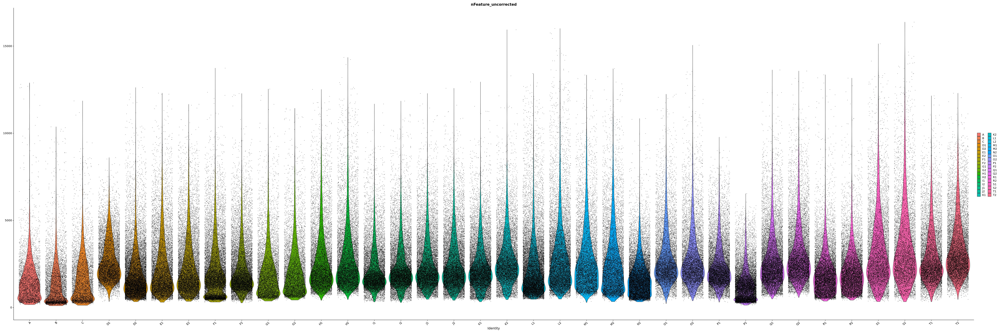

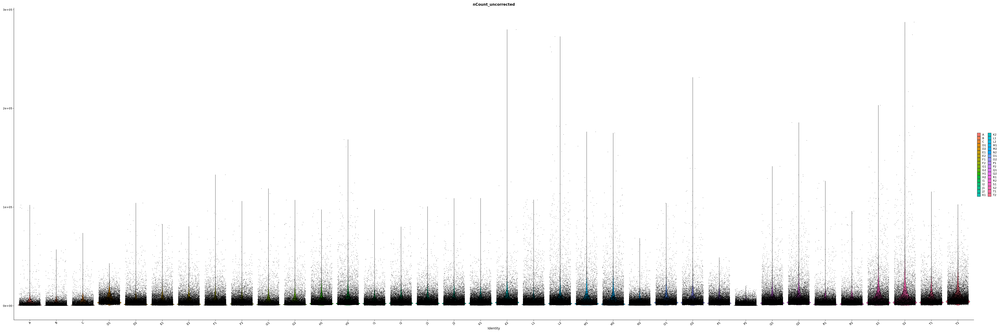

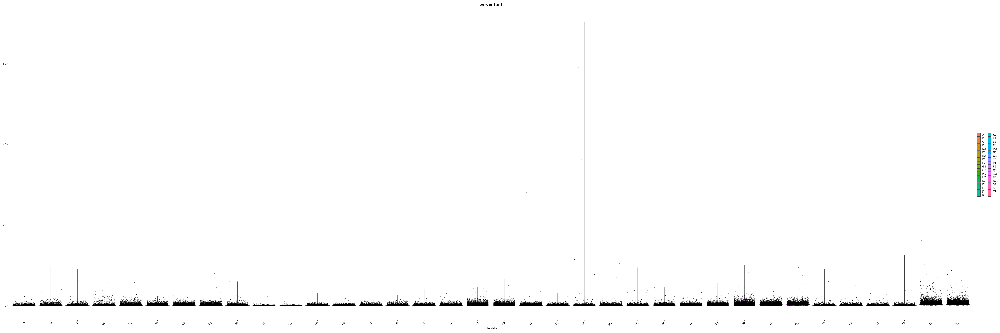

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



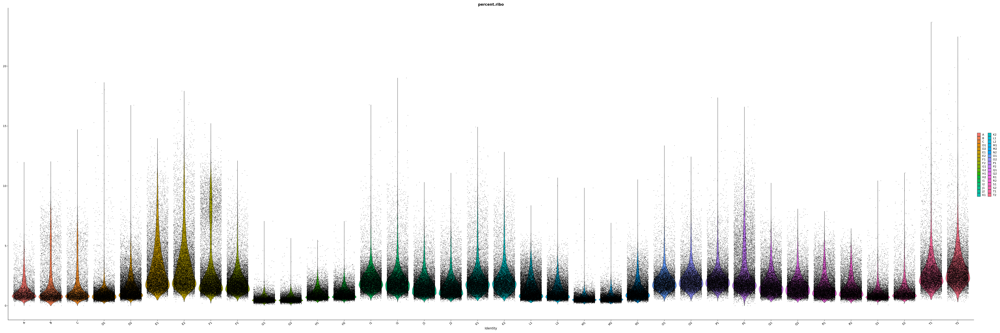

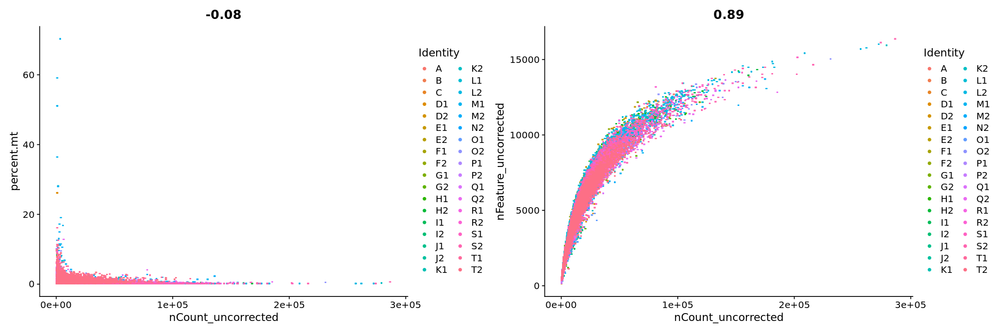

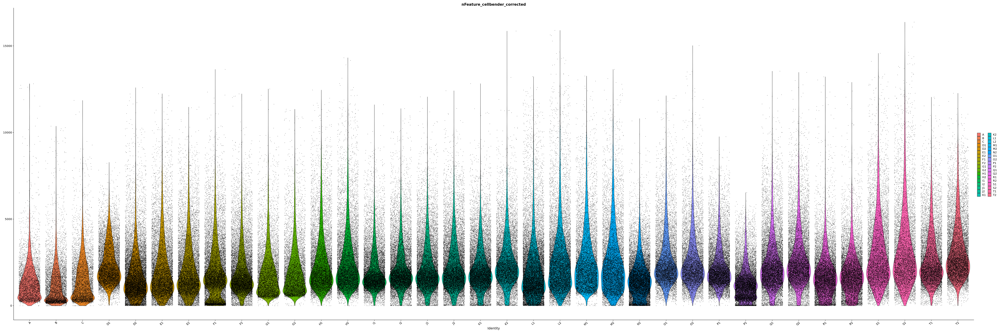

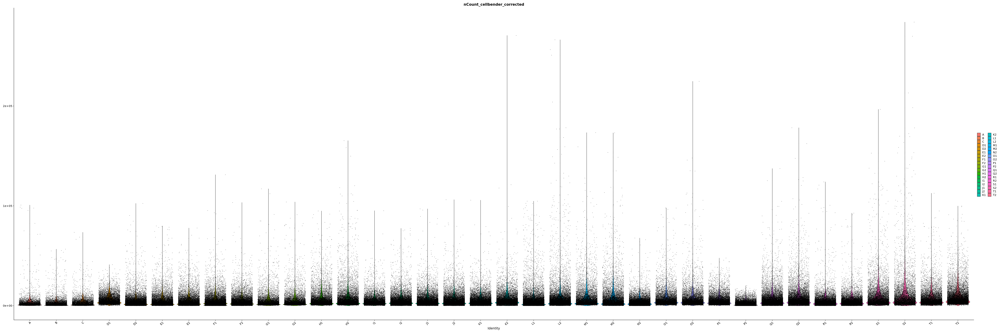

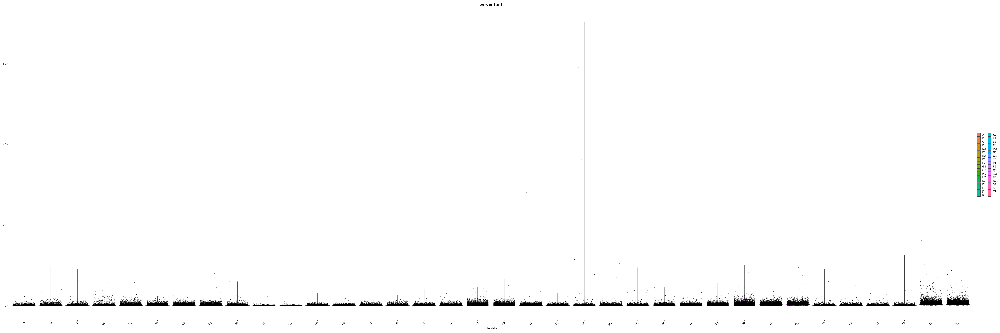

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



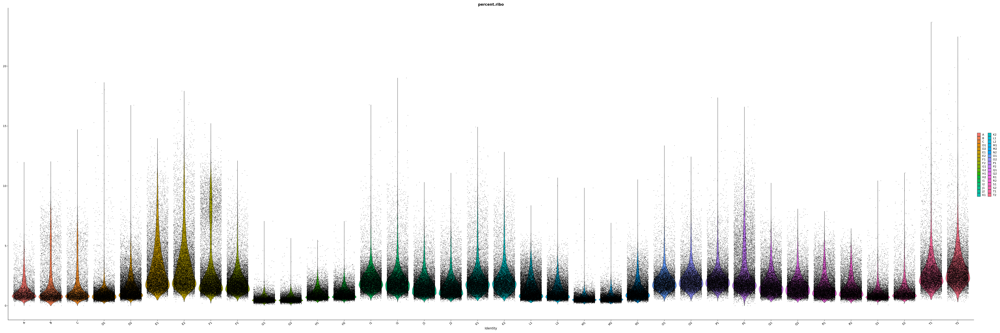

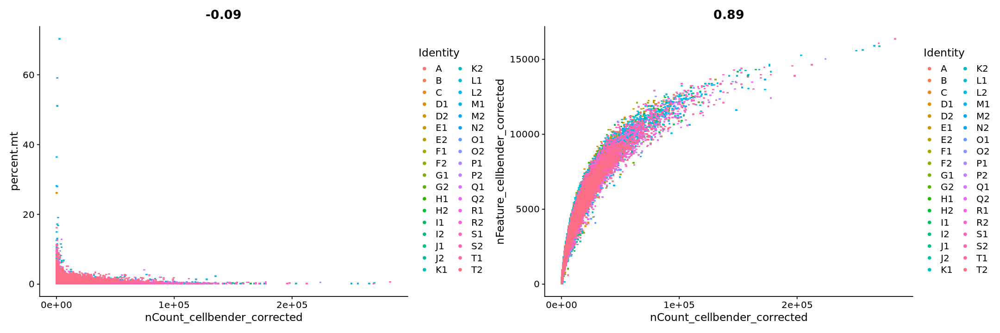

In [4]:
options(repr.plot.width=60, repr.plot.height=20)

VlnPlot(combined_dataset, features = c("nFeature_uncorrected"))
VlnPlot(combined_dataset, features = c("nCount_uncorrected"))
VlnPlot(combined_dataset, features = c("percent.mt"))
VlnPlot(combined_dataset, features = c("percent.ribo"))

options(repr.plot.width=18, repr.plot.height=6)

plot1 <- FeatureScatter(combined_dataset, feature1 = "nCount_uncorrected", feature2 = "percent.mt")
plot2 <- FeatureScatter(combined_dataset, feature1 = "nCount_uncorrected", feature2 = "nFeature_uncorrected")
plot1 + plot2

options(repr.plot.width=60, repr.plot.height=20)

VlnPlot(combined_dataset, features = c("nFeature_cellbender_corrected"))
VlnPlot(combined_dataset, features = c("nCount_cellbender_corrected"))
VlnPlot(combined_dataset, features = c("percent.mt"))
VlnPlot(combined_dataset, features = c("percent.ribo"))

options(repr.plot.width=18, repr.plot.height=6)

plot1 <- FeatureScatter(combined_dataset, feature1 = "nCount_cellbender_corrected", feature2 = "percent.mt")
plot2 <- FeatureScatter(combined_dataset, feature1 = "nCount_cellbender_corrected", feature2 = "nFeature_cellbender_corrected")
plot1 + plot2

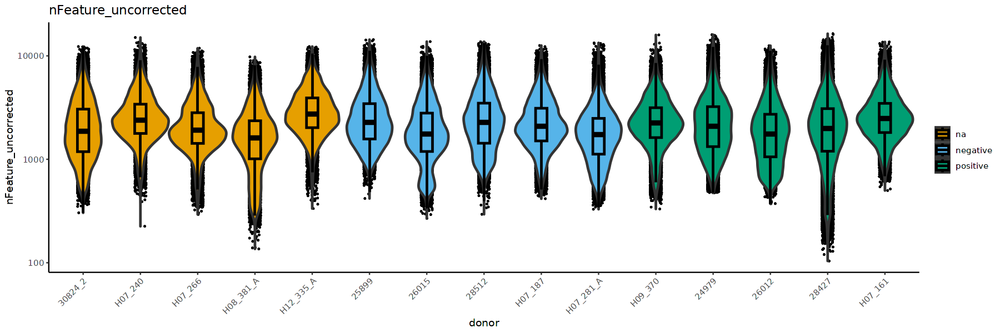

Warning message:
“Transformation introduced infinite values in continuous y-axis”
Warning message:
“Transformation introduced infinite values in continuous y-axis”
Warning message:
“Transformation introduced infinite values in continuous y-axis”


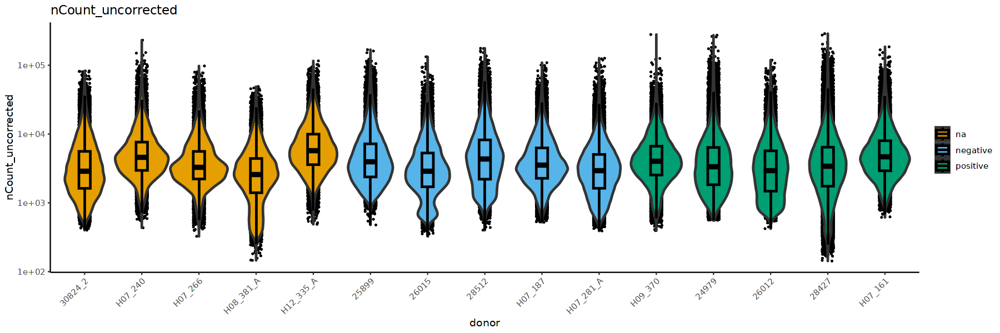

Warning message:
“Transformation introduced infinite values in continuous y-axis”
Warning message:
“Transformation introduced infinite values in continuous y-axis”
Warning message:
“Transformation introduced infinite values in continuous y-axis”


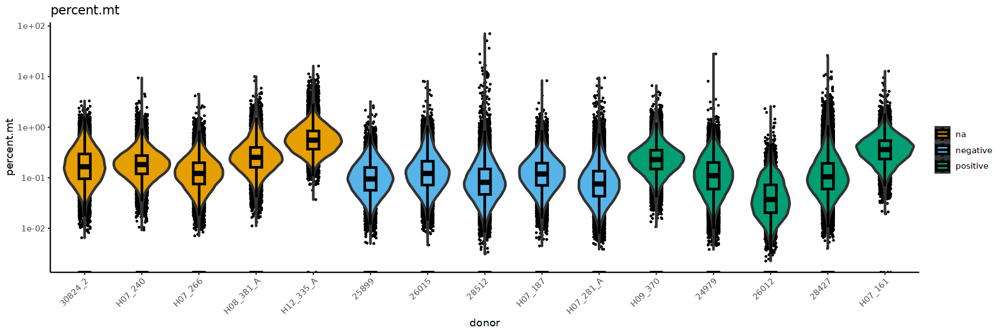

In [6]:
options(repr.plot.width=15, repr.plot.height=5)

dittoPlot(combined_dataset, "nFeature_uncorrected", group.by = "donor", color.by = "ebv_status", x.reorder = c(7,10,11,13,15,2,4,6,9,12,14,1,3,5,8), plots = c("jitter", "vlnplot", "boxplot"), do.raster = TRUE) + scale_y_log10()
ggsave("nFeature_uncorrected_by_donor.pdf", width = 15, height = 5)

dittoPlot(combined_dataset, "nCount_uncorrected", group.by = "donor", color.by = "ebv_status", x.reorder = c(7,10,11,13,15,2,4,6,9,12,14,1,3,5,8), plots = c("jitter", "vlnplot", "boxplot"), do.raster = TRUE) + scale_y_log10()
ggsave("nCount_uncorrected_by_donor.pdf", width = 15, height = 5)

dittoPlot(combined_dataset, "percent.mt", group.by = "donor", color.by = "ebv_status", x.reorder = c(7,10,11,13,15,2,4,6,9,12,14,1,3,5,8), plots = c("jitter", "vlnplot", "boxplot"), do.raster = TRUE) + scale_y_log10()
ggsave("percent.mt_by_donor.pdf", width = 15, height = 5)


`summarise()` has grouped output by 'donor'. You can override using the `.groups` argument.


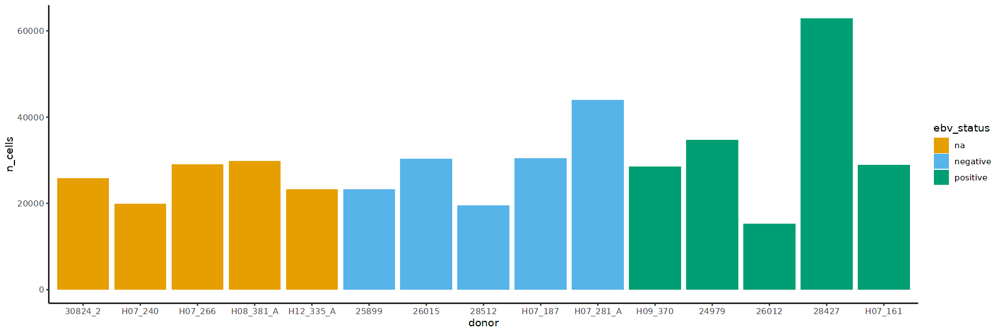

In [19]:
##Median/mean genes, transcripts and reads per cell
qc.data <- combined_dataset@meta.data %>% group_by(donor, ebv_status) %>% summarize(n_cells = n(), median_genes = median(nFeature_uncorrected), mean_genes = mean(nFeature_uncorrected), median_transcripts = median(nCount_uncorrected), mean_transcripts = mean(nCount_uncorrected))
write.csv(qc.data, "qc_data.csv")

qc.data.by.lane <- combined_dataset@meta.data %>% group_by(gem_lane) %>% summarize(n_cells = n(), median_genes = median(nFeature_uncorrected), mean_genes = mean(nFeature_uncorrected), median_transcripts = median(nCount_uncorrected), mean_transcripts = mean(nCount_uncorrected))
write.csv(qc.data.by.lane, "qc_data_by_lane.csv")
##Need to work on reads per cell - get it from 10x summary sheet 

## total number of cells passing QC

qc.data$donor <- factor(qc.data$donor, levels = c("30824_2", "H07_240", "H07_266", "H08_381_A", "H12_335_A", "25899", "26015", "28512", "H07_187", "H07_281_A", "H09_370", "24979", "26012", "28427", "H07_161"))

qc.data %>% ggplot(aes(x = donor, y = n_cells, fill = ebv_status)) + geom_bar(stat="identity") + theme_classic() + scale_fill_manual(values = dittoColors())

ggsave("n_cells_by_donor.pdf", width = 15, height = 5)


## Doubet classification with scDblFinder

In [5]:
##QC filter on uncorrected count matrix

DefaultAssay(combined_dataset) <- "uncorrected"
combined_dataset <- subset(combined_dataset, subset = nCount_uncorrected > 200)

## Convert to SCE object for running scDoubletfinder
## We want all operations on the sce object to run on the RNA assay and not the corrected assay for now so setting the corrected assay as the alternate experiment

combined_dataset_sce <- as.SingleCellExperiment(combined_dataset, assay = "uncorrected")

altExp(combined_dataset_sce, "cellbender_corrected") <- as.SingleCellExperiment(combined_dataset, assay = "cellbender_corrected")

## Run doublet detection with scDoubletfinder

combined_dataset_sce <- scDblFinder(combined_dataset_sce, samples = "gem_lane", BPPARAM=MulticoreParam(59))

combined_dataset <- as.Seurat(combined_dataset_sce)

## the conversion back to Seurat object for some reason renames the RNA assay to originalexp

combined_dataset <- RenameAssays(combined_dataset, originalexp = "uncorrected")

## the default assay also changes to the cellbender_corrected assay so change to RNA uncorrected data

DefaultAssay(combined_dataset) <- "uncorrected"

An object of class Seurat 
59638 features across 445039 samples within 2 assays 
Active assay: uncorrected (29852 features, 0 variable features)
 1 other assay present: cellbender_corrected

## Apply QC filters and remove doublets

In [9]:
#QC filters and remove doublets 
DefaultAssay(combined_dataset) <- "cellbender_corrected"

combined_dataset <- subset(combined_dataset, subset = nFeature_cellbender_corrected > 200 & nCount_cellbender_corrected > 400 & percent.mt < 5 & scDblFinder.class == "singlet")
combined_dataset

An object of class Seurat 
59638 features across 359253 samples within 2 assays 
Active assay: cellbender_corrected (29786 features, 0 variable features)
 1 other assay present: uncorrected

## Dimensionality reduction and visualization of filtered dataset

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



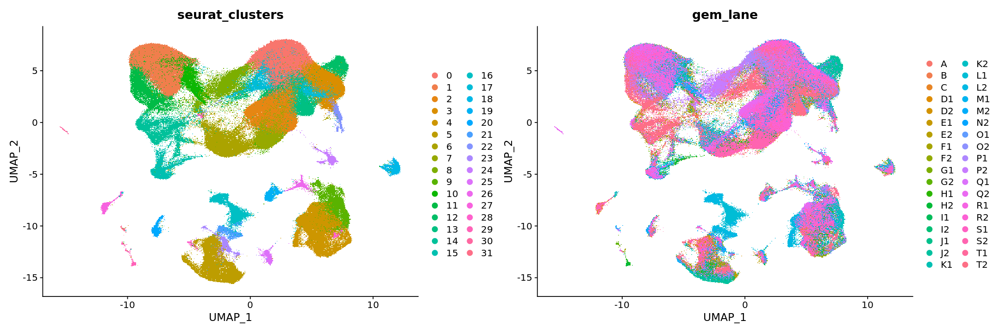

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



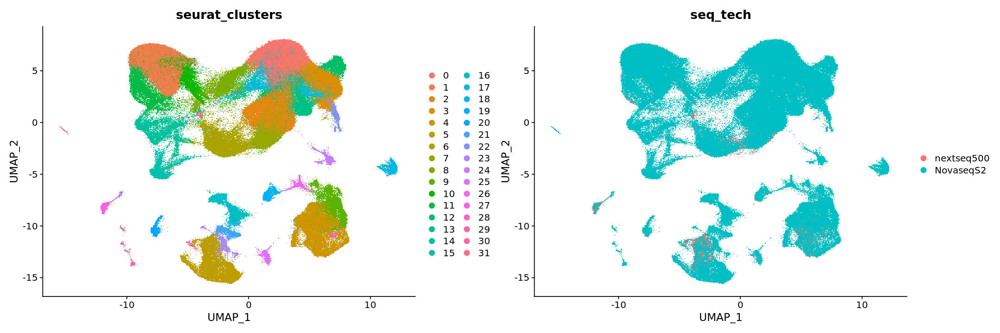

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



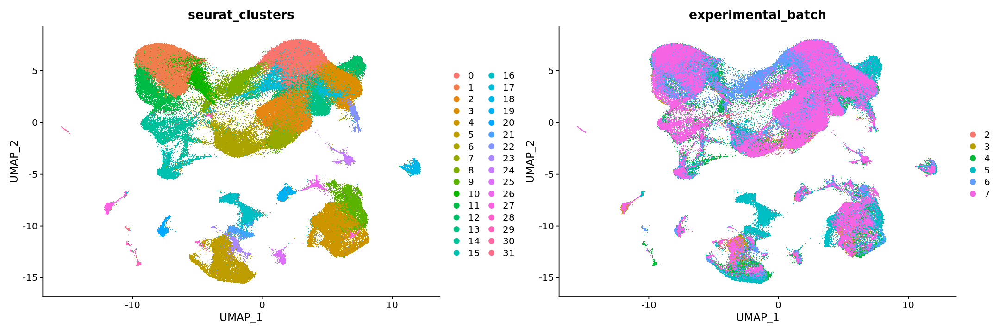

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



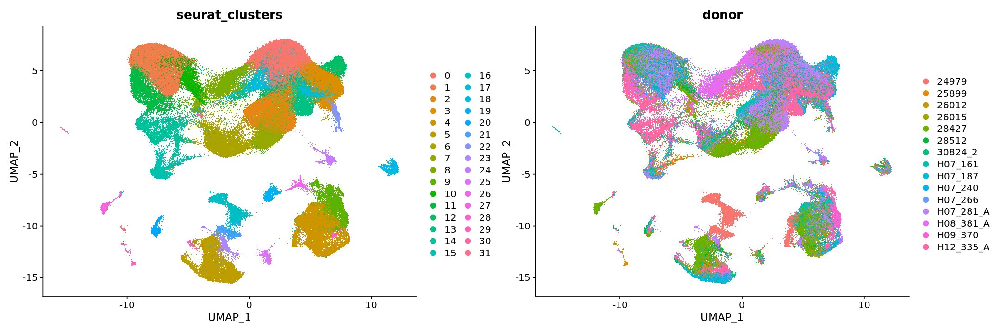

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



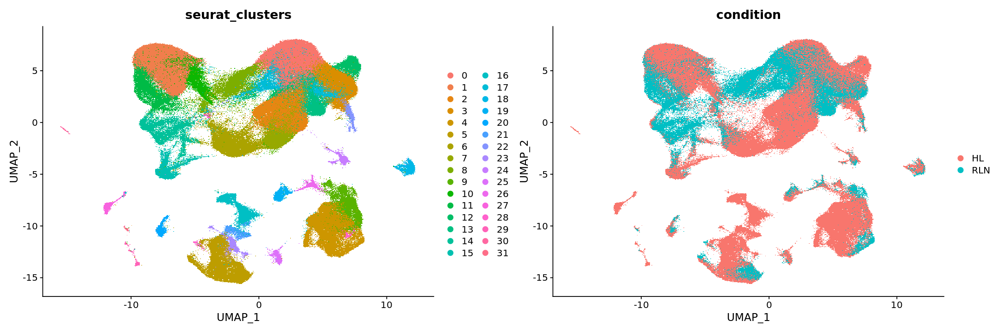

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



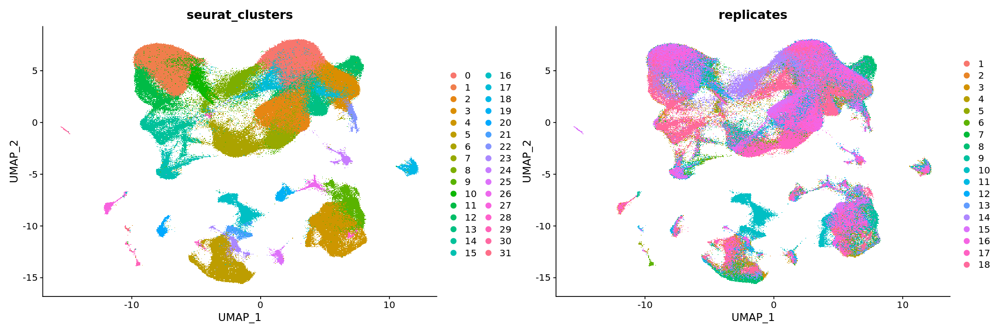

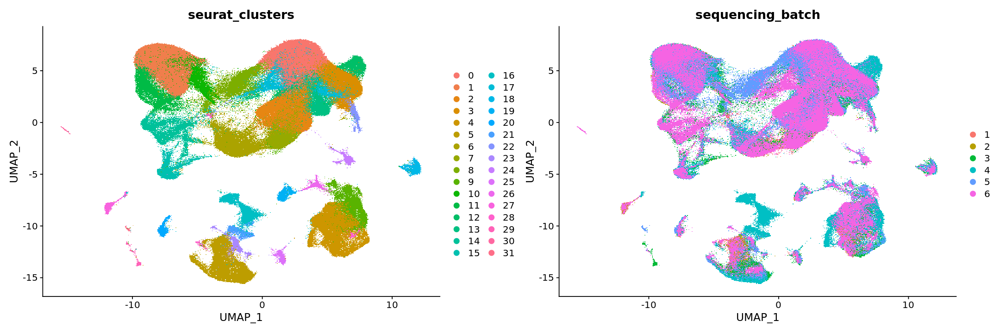

In [11]:
## Standard Seurat workflow 

combined_dataset <- combined_dataset %>% NormalizeData() %>% FindVariableFeatures(selection.method = "vst", nfeatures = 2000) %>% ScaleData() %>% RunPCA() %>% FindNeighbors(dims = 1:50) %>% FindClusters(resolution = 0.5) %>% RunUMAP(dims = 1:50)

## Visualize distribution of metadata 

options(repr.plot.width=18, repr.plot.height=6)

p1 <- DimPlot(combined_dataset, reduction = "umap", group.by = "seurat_clusters")
p2 <- DimPlot(combined_dataset, reduction = "umap", group.by = "gem_lane")


p1 + p2

p1 <- DimPlot(combined_dataset, reduction = "umap", group.by = "seurat_clusters")
p2 <- DimPlot(combined_dataset, reduction = "umap", group.by = "seq_tech")

p1 + p2

p1 <- DimPlot(combined_dataset, reduction = "umap", group.by = "seurat_clusters")
p2 <- DimPlot(combined_dataset, reduction = "umap", group.by = "experimental_batch")


p1 + p2

p1 <- DimPlot(combined_dataset, reduction = "umap", group.by = "seurat_clusters")
p2 <- DimPlot(combined_dataset, reduction = "umap", group.by = "donor")


p1 + p2

p1 <- DimPlot(combined_dataset, reduction = "umap", group.by = "seurat_clusters")
p2 <- DimPlot(combined_dataset, reduction = "umap", group.by = "condition")


p1 + p2

p1 <- DimPlot(combined_dataset, reduction = "umap", group.by = "seurat_clusters")
p2 <- DimPlot(combined_dataset, reduction = "umap", group.by = "replicates")


p1 + p2

p1 <- DimPlot(combined_dataset, reduction = "umap", group.by = "seurat_clusters")
p2 <- DimPlot(combined_dataset, reduction = "umap", group.by = "sequencing_batch")


p1 + p2


## Batch correction with Harmony

Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 17962650)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 17962650)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 17962650)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 17962650)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 17962650)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 17962650)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 17962650)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 17962650)”
Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony 6/10

Harmony 7/10

Harmony 8/10

Harmony 9/10

Harmony 10/10

Warning message:
“Invalid name supplied, making object name syntactically valid. New object name is Seurat..ProjectDim.cellbender_corrected.harmony; see ?make.names for more details on syntax validity”


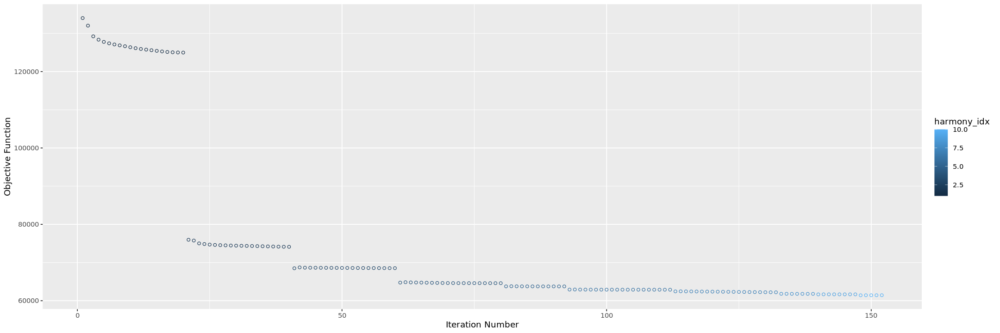

In [12]:
options(repr.plot.width=18, repr.plot.height=6)

combined_dataset_corrected <- RunHarmony(combined_dataset, c("sequencing_batch", "experimental_batch", "seq_tech", "donor", "gem_lane"), plot_convergence = TRUE, assay.use = "cellbender_corrected")


In [16]:
combined_dataset_corrected <- combined_dataset_corrected %>% RunUMAP(reduction = "harmony", dims = 1:50) %>% FindNeighbors(reduction = "harmony", dims = 1:50) %>% FindClusters(resolution = 0.3) 


04:33:44 UMAP embedding parameters a = 0.9922 b = 1.112

04:33:44 Read 359253 rows and found 50 numeric columns

04:33:44 Using Annoy for neighbor search, n_neighbors = 30

04:33:44 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

04:35:07 Writing NN index file to temp file /tmp/RtmpVkImVY/file10695060fc0

04:35:07 Searching Annoy index using 1 thread, search_k = 3000

04:39:23 Annoy recall = 100%

04:39:25 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

04:39:52 Initializing from normalized Laplacian + noise (using irlba)

04:41:38 Commencing optimization for 200 epochs, with 17920318 positive edges

04:46:14 Optimization finished

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 359253
Number of edges: 11308356

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9549
Number of communities: 114
Elapsed time: 315 seconds


94 singletons identified. 20 final clusters.



Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



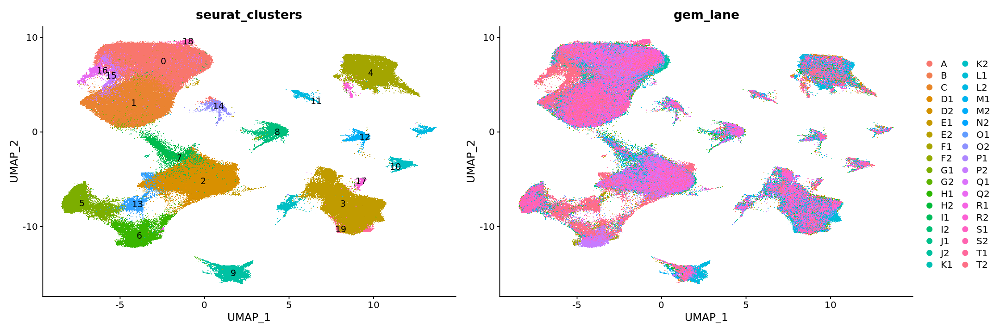

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



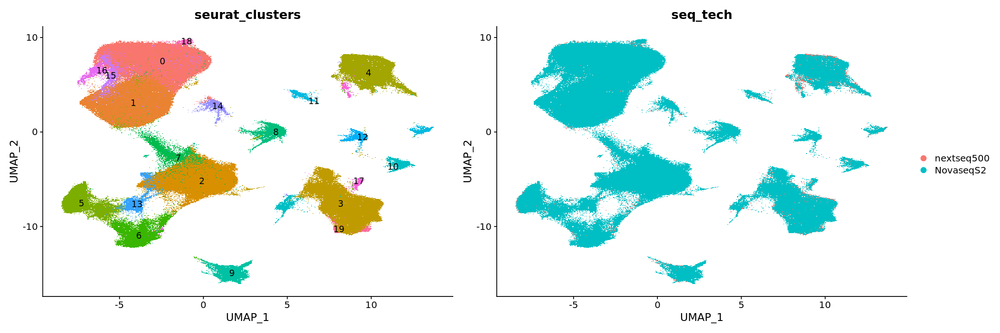

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



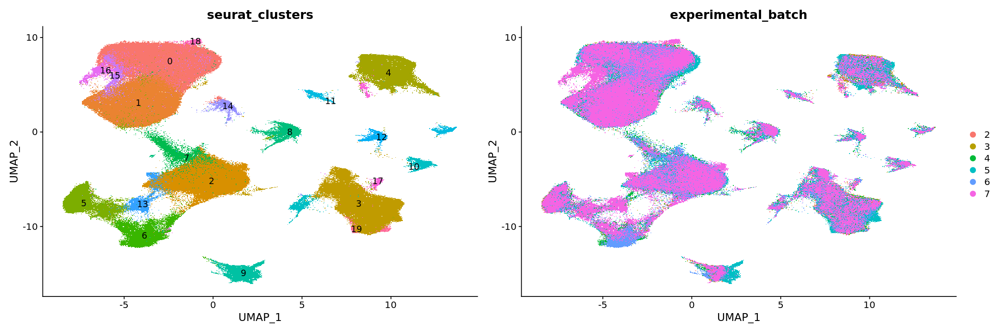

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



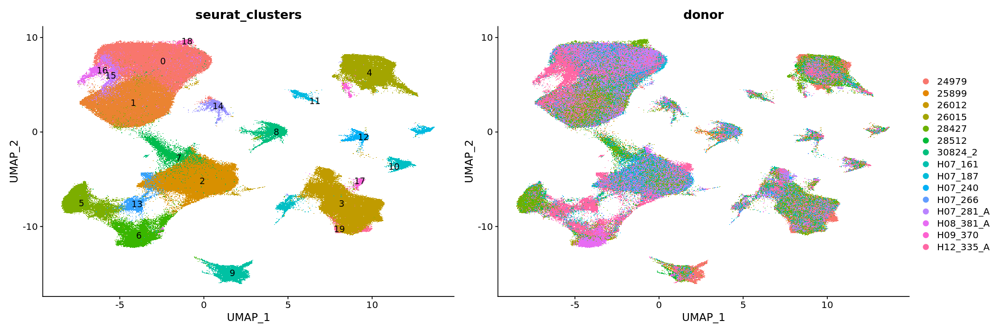

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



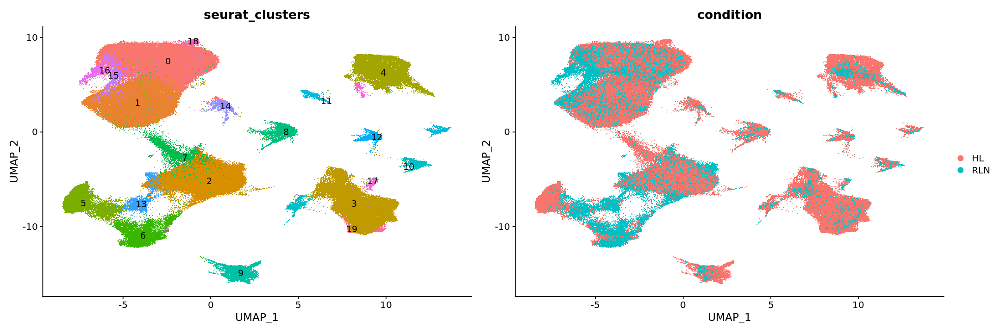

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



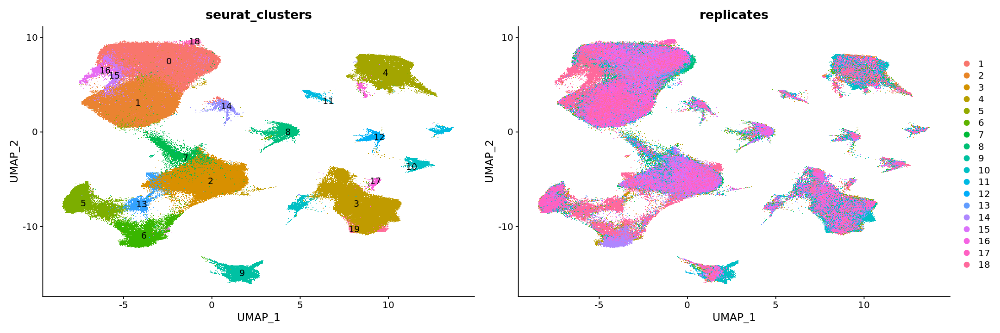

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



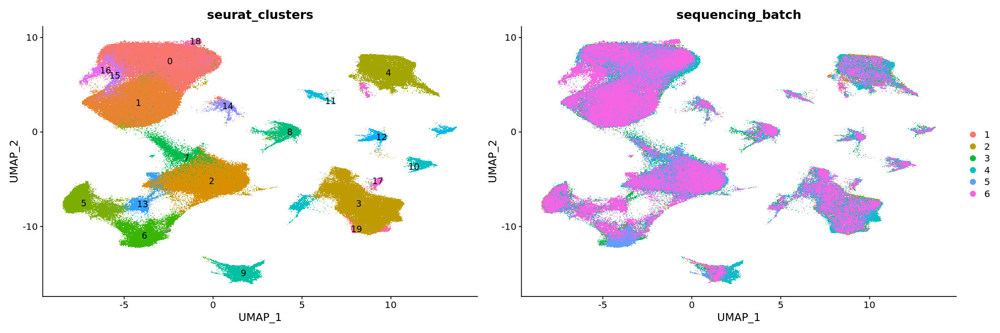

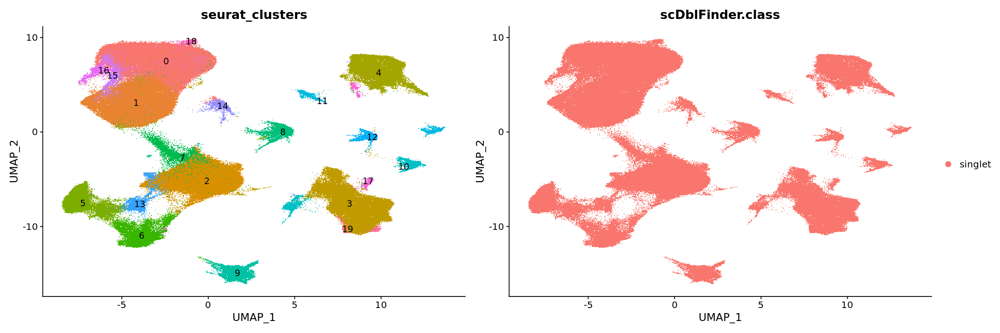

In [17]:
## Visualize distribution of metadata 

options(repr.plot.width=18, repr.plot.height=6)

p1 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "seurat_clusters", label = TRUE) +NoLegend()
p2 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "gem_lane")


p1 + p2

p1 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "seurat_clusters", label = TRUE) +NoLegend()
p2 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "seq_tech")

p1 + p2

p1 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "seurat_clusters", label = TRUE) +NoLegend()
p2 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "experimental_batch")


p1 + p2

p1 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "seurat_clusters", label = TRUE) +NoLegend()
p2 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "donor")


p1 + p2

p1 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "seurat_clusters", label = TRUE) +NoLegend()
p2 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "condition")


p1 + p2

p1 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "seurat_clusters", label = TRUE) +NoLegend()
p2 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "replicates")


p1 + p2

p1 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "seurat_clusters", label = TRUE) +NoLegend()
p2 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "sequencing_batch")


p1 + p2

p1 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "seurat_clusters", label = TRUE) +NoLegend()
p2 <- DimPlot(combined_dataset_corrected, reduction = "umap", group.by = "scDblFinder.class")


p1 + p2

In [18]:
##Save object 

setwd("/home/vshanmug/results/073122_combined_analysis_single_nucleus_data/")

SaveH5Seurat(combined_dataset_corrected, filename = "combined_dataset_cellbender_integrated.h5Seurat", overwrite = TRUE)

Warning message:
“Overwriting previous file combined_dataset_cellbender_integrated.h5Seurat”
Creating h5Seurat file for version 3.1.5.9900

Adding counts for cellbender_corrected

Adding data for cellbender_corrected

Adding scale.data for cellbender_corrected

Adding variable features for cellbender_corrected

Adding feature-level metadata for cellbender_corrected

Adding counts for uncorrected

Adding data for uncorrected

No variable features found for uncorrected

No feature-level metadata found for uncorrected

Adding cell embeddings for pca

Adding loadings for pca

No projected loadings for pca

Adding standard deviations for pca

No JackStraw data for pca

Adding cell embeddings for umap

No loadings for umap

No projected loadings for umap

No standard deviations for umap

No JackStraw data for umap

Adding cell embeddings for harmony

Adding loadings for harmony

Adding projected loadings for harmony

Adding standard deviations for harmony

No JackStraw data for harmony



## Visualize cell type-specific genes to assess the effect of ambient RNA correction using Cellbender

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



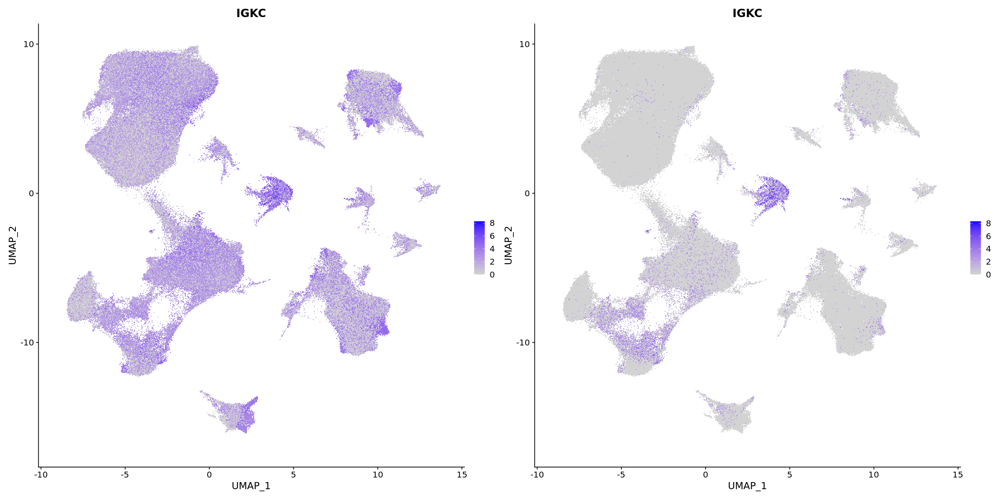

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



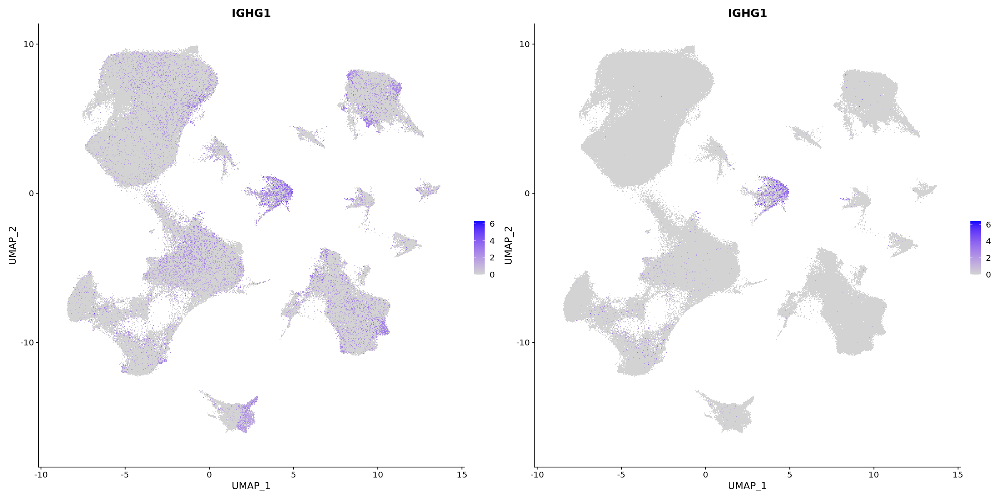

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



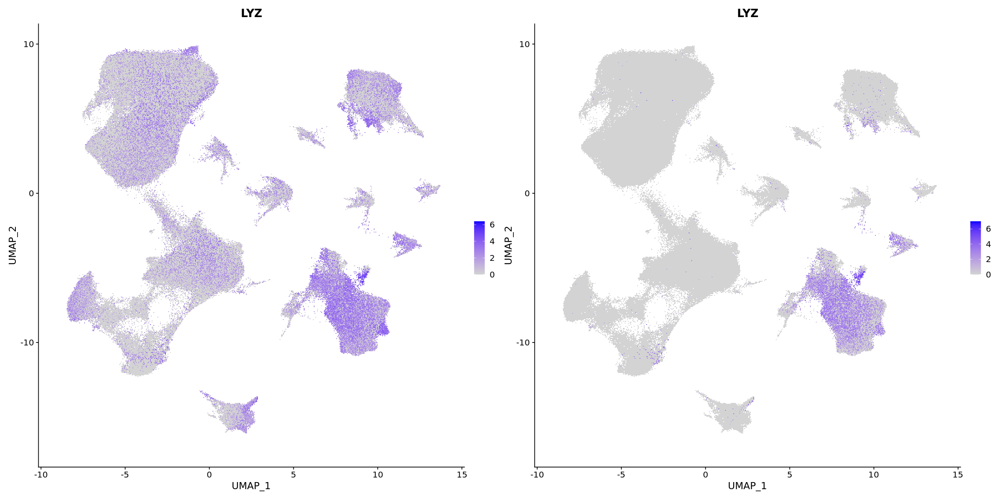

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



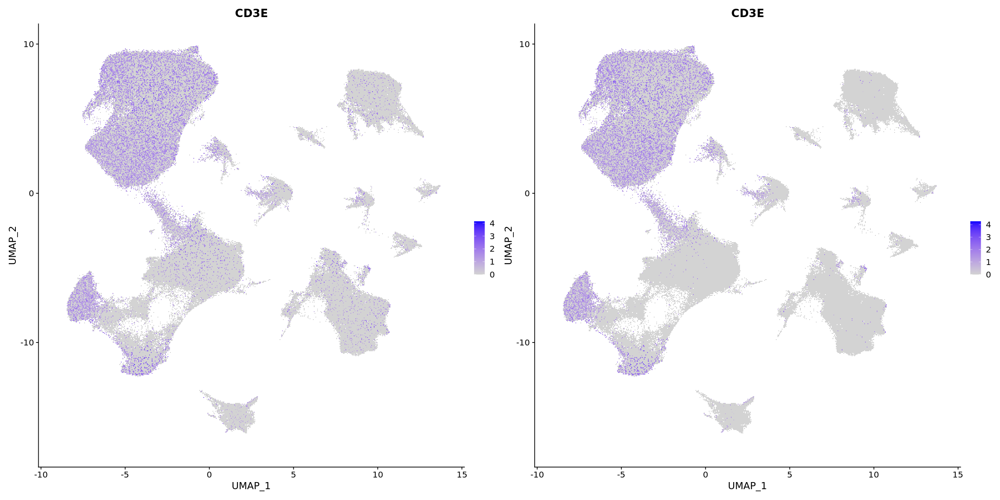

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



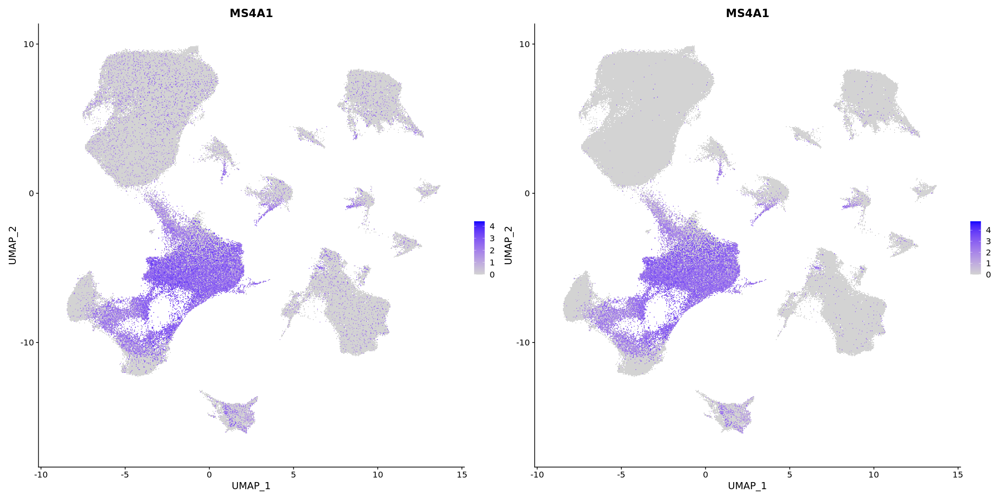

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



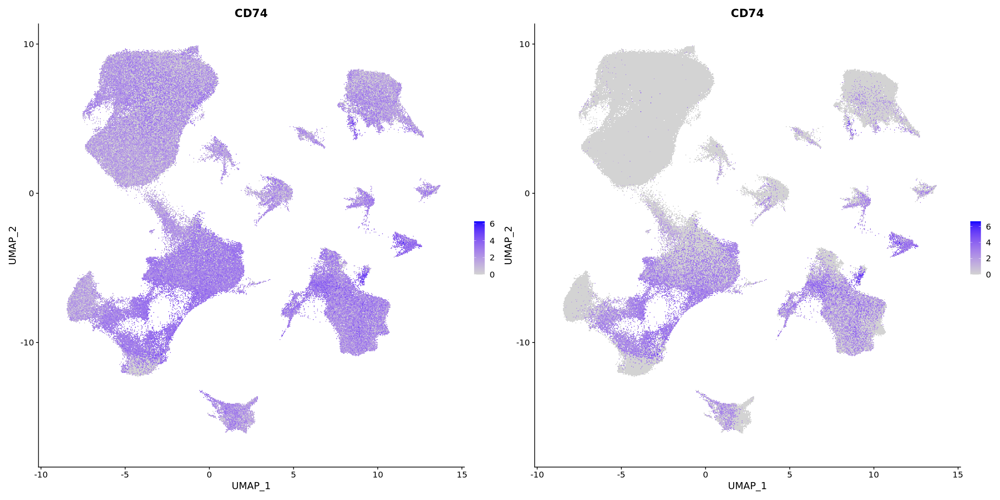

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



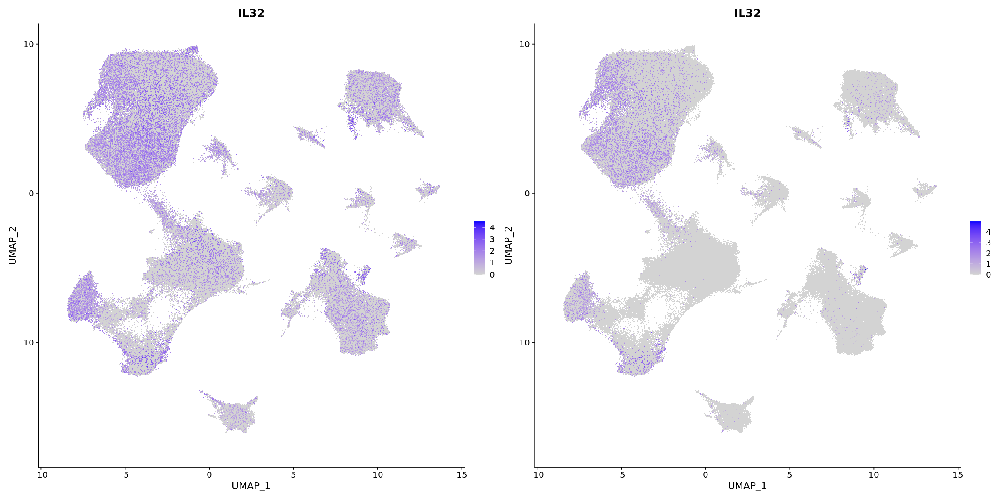

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



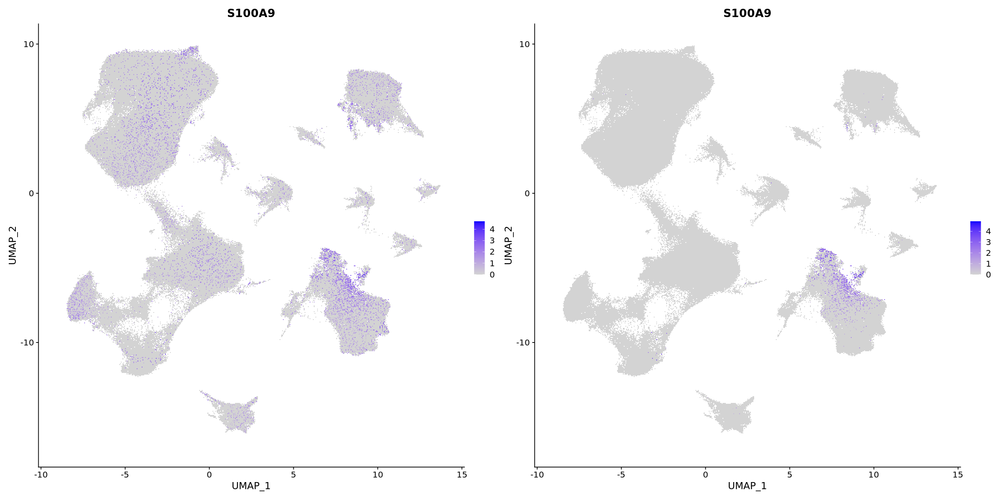

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



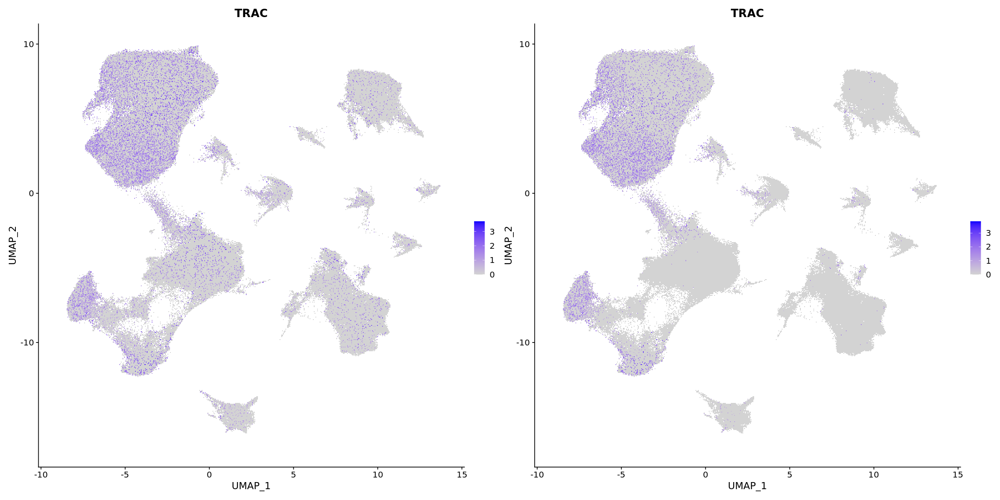

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



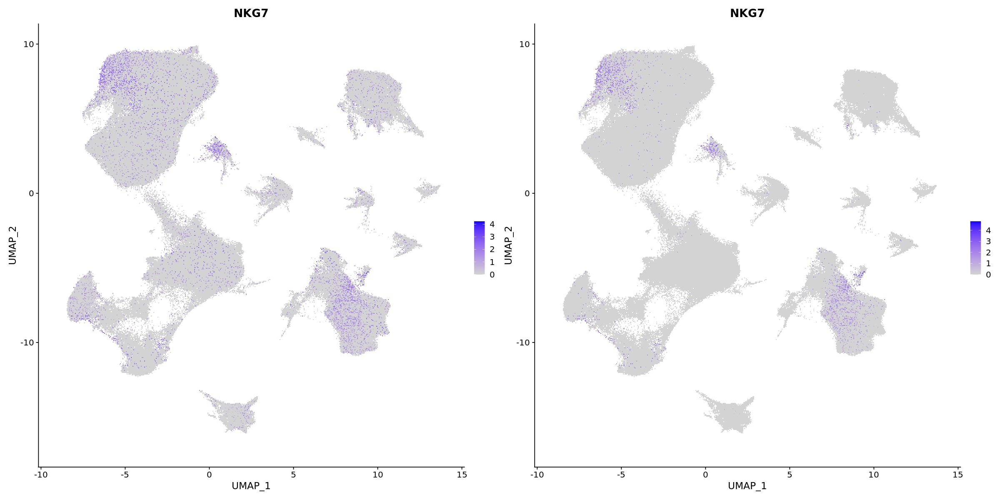

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



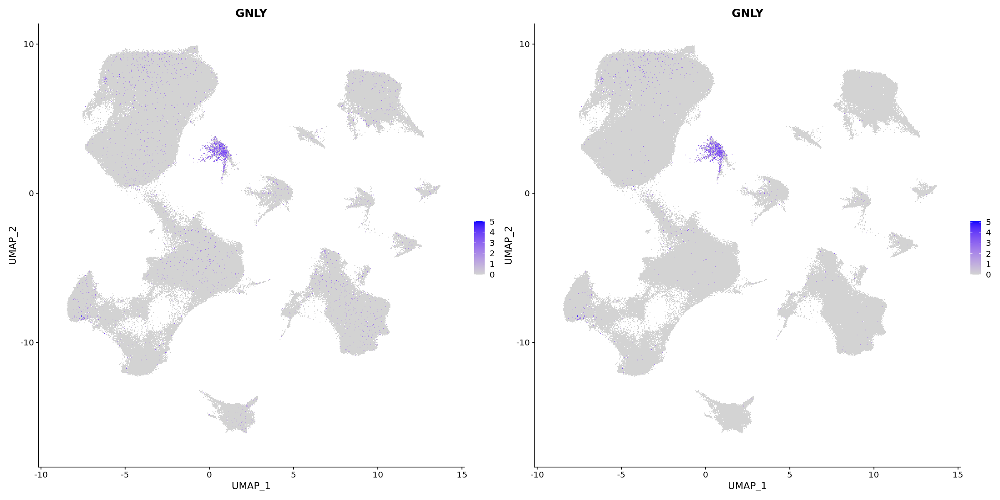

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



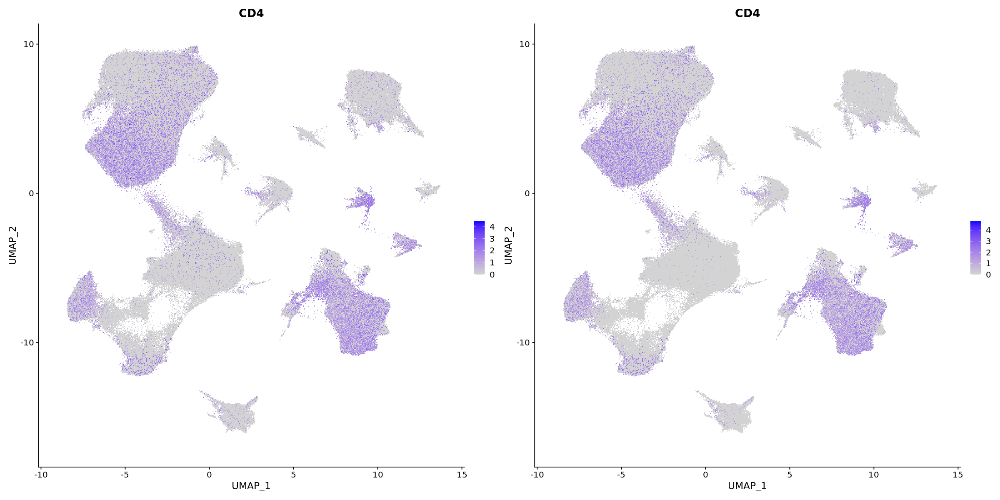

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



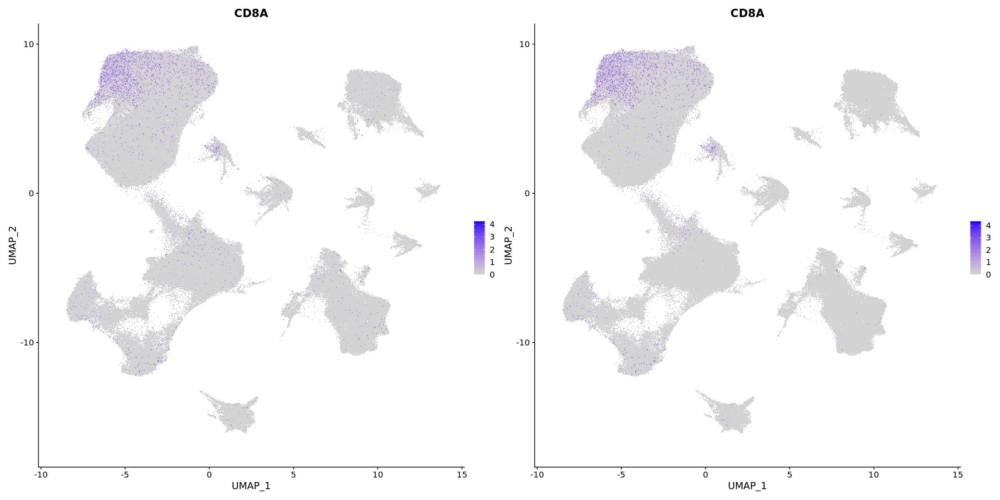

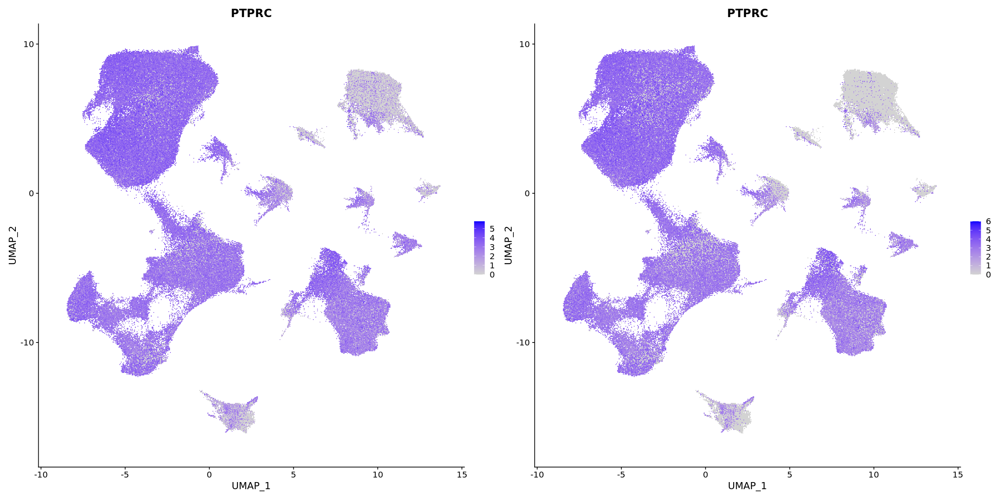

In [30]:
DefaultAssay(combined_dataset_corrected) <- "uncorrected"

combined_dataset_corrected <- combined_dataset_corrected %>% NormalizeData()

options(repr.plot.width=20, repr.plot.height=10)
DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("IGKC"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("IGKC"), slot = "data")

p1 | p2

DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("IGHG1"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("IGHG1"), slot = "data")

p1 | p2

DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("LYZ"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("LYZ"), slot = "data")

p1 | p2

DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("CD3E"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("CD3E"), slot = "data")

p1 | p2

DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("MS4A1"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("MS4A1"), slot = "data")

p1 | p2


DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("CD74"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("CD74"), slot = "data")

p1 | p2

DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("IL32"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("IL32"), slot = "data")

p1 | p2

DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("S100A9"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("S100A9"), slot = "data")

p1 | p2

DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("TRAC"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("TRAC"), slot = "data")

p1 | p2

DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("NKG7"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("NKG7"), slot = "data")

p1 | p2

DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("GNLY"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("GNLY"), slot = "data")

p1 | p2

DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("CD4"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("CD4"), slot = "data")

p1 | p2

DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("CD8A"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("CD8A"), slot = "data")

p1 | p2

DefaultAssay(combined_dataset_corrected) <- "uncorrected"
p1 <- FeaturePlot(combined_dataset_corrected, features = c("PTPRC"), slot = "data")
DefaultAssay(combined_dataset_corrected) <- "cellbender_corrected"
p2 <- FeaturePlot(combined_dataset_corrected, features = c("PTPRC"), slot = "data")

p1 | p2

In [49]:
combined_dataset_corrected_final <- DietSeurat(combined_dataset_corrected, assays = "cellbender_corrected", dimreducs = c("harmony", "pca", "umap"))

##Save object 

setwd("/home/vshanmug/results/073122_combined_analysis_single_nucleus_data/")

SaveH5Seurat(combined_dataset_corrected_final, filename = "combined_dataset_cellbender_final.h5Seurat", overwrite = TRUE)

Warning message:
“Overwriting previous file combined_dataset_cellbender_final.h5Seurat”
Creating h5Seurat file for version 3.1.5.9900

Adding counts for cellbender_corrected

Adding data for cellbender_corrected

Adding variable features for cellbender_corrected

Adding feature-level metadata for cellbender_corrected

Adding cell embeddings for harmony

Adding loadings for harmony

Adding projected loadings for harmony

Adding standard deviations for harmony

No JackStraw data for harmony

Adding cell embeddings for pca

Adding loadings for pca

No projected loadings for pca

Adding standard deviations for pca

No JackStraw data for pca

Adding cell embeddings for umap

No loadings for umap

No projected loadings for umap

No standard deviations for umap

No JackStraw data for umap

